# 2023 Analysis by Council District

In [1]:
import seaborn as sns
sns.set()
sns.set_palette("Dark2")

# automatically reload utils module when it changes
%load_ext autoreload
%autoreload 2

# import utility functions
import sys
sys.path.append('../')
from src.utils import *

# set plotting defaults
%matplotlib inline
import matplotlib as mpl
mpl.rcParams['figure.dpi']= 300

# requires version 0.12.0 or higher
sns.__version__

'0.12.2'

In [2]:
# required for spatial analysis and plotting
import geopandas as gpd
import contextily as cx

In [3]:
gdf_full = get_data(2023, geo=True)

Breakdown by Outlier Condition:
	Outlier Rents: 5461 (30%)
	Outlier Increase vs Base: 608 ( 3%)
	Outlier Increase vs Previous: 328 ( 2%)
	Overall: 5905 (33%)

Breakdown by Subset:
	5905 outliers (33%)
	12081 non-outliers (67%)


	8567 rent increase (48%)
	9419 no rent increase (52%)


	7146 exempt (40%)
	10840 not exempt (60%)


For this analysis, we will drop parcels that cannot be correctly mapped to a ward.

In [4]:
gdf = gdf_full.dropna(subset=["WARD"])
print(f"Number of parcels with Ward data: {len(gdf)} ({len(gdf)/len(gdf_full)*100:2.1f}%)")
print(f"Number of parcels without Ward data: {len(gdf_full) - len(gdf)} ({(len(gdf_full) - len(gdf))/len(gdf_full)*100:2.1f}%)")

Number of parcels with Ward data: 17818 (99.1%)
Number of parcels without Ward data: 168 (0.9%)


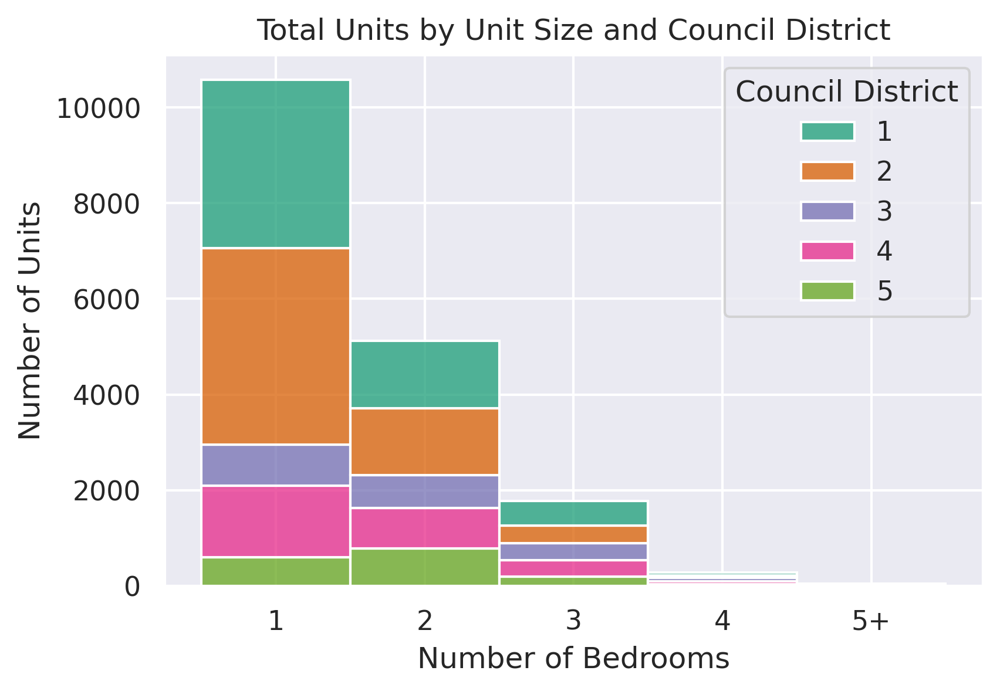

In [28]:
ax = sns.histplot(
    data=gdf.sort_values(by="WARD_str"),
    x='nbrBedRms_grouped',
    hue='WARD_str',
    multiple='stack'
    )
ax.set_title("Total Units by Unit Size and Council District")
ax.set_xlabel("Number of Bedrooms")
ax.set_ylabel("Number of Units")
ax.get_legend().set_title("Council District")

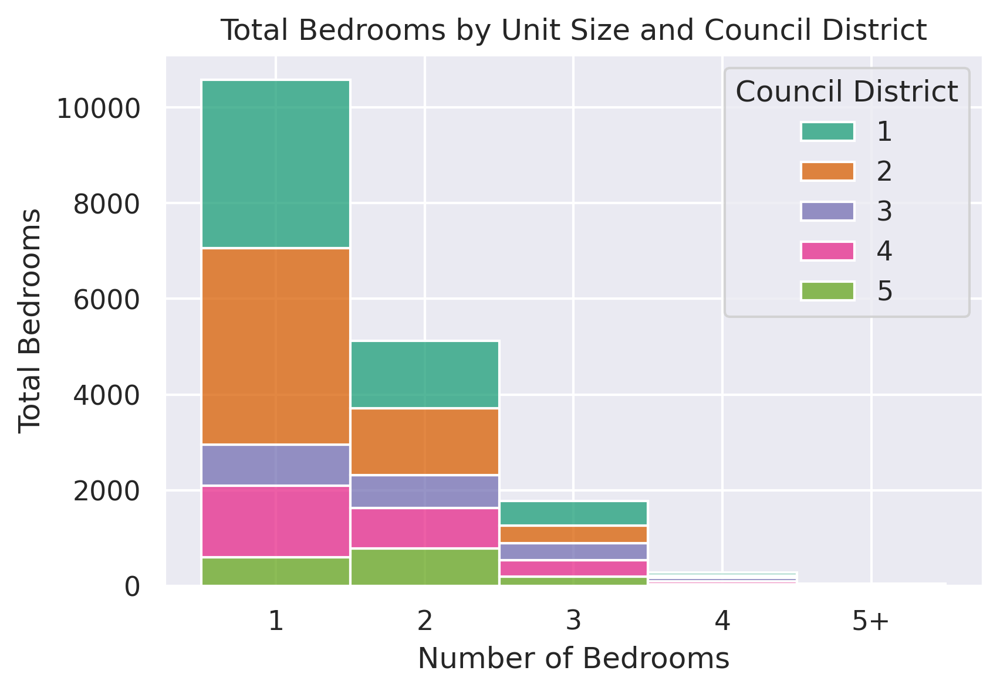

In [29]:
ax = sns.histplot(
    data=gdf.sort_values(by="WARD_str"),
    x='nbrBedRms_grouped',
    hue='WARD_str',
    multiple='stack'
    )
ax.set_title("Total Bedrooms by Unit Size and Council District")
ax.set_xlabel("Number of Bedrooms")
ax.set_ylabel("Total Bedrooms")
ax.get_legend().set_title("Council District")

In [7]:
wards = gpd.read_file("../../municipal-street-list/wards.geojson").to_crs(3857)
wards["NAME"] = wards["NAME"].astype(float)

In [8]:
gdf.to_file("../data/2023-report-summary.geojson")

In [9]:
quantiles = gdf[~gdf["outlier"]][numerical_columns].quantile([.05, .95])

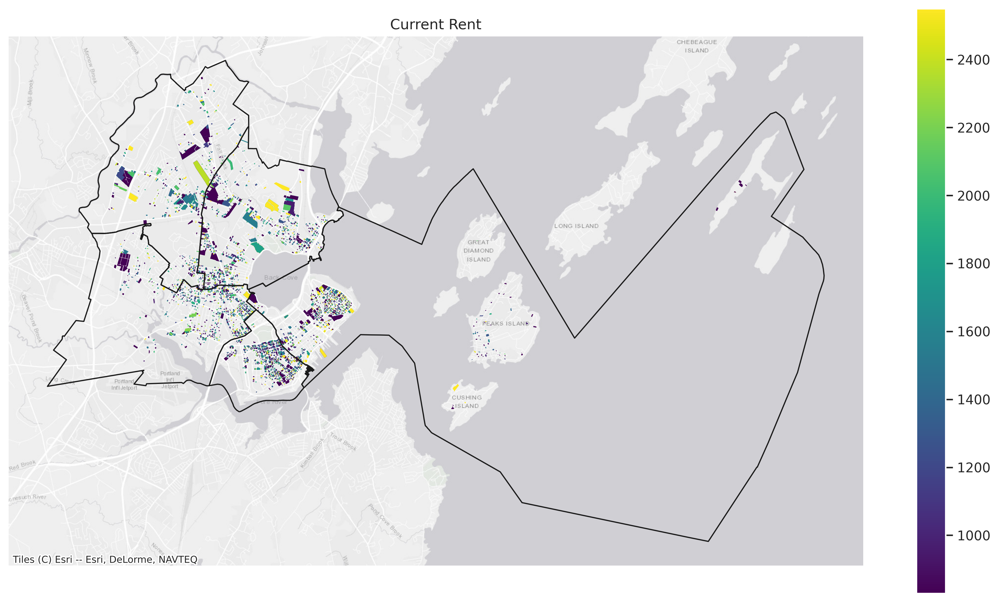

In [10]:
ax = gdf.plot(
    "CurrentRent1", 
    figsize=(16,9), 
    legend=True, 
    cmap="viridis", edgecolor="none",
    vmin=quantiles["CurrentRent1"].iloc[0], 
    vmax=quantiles["CurrentRent1"].iloc[1],)
ax.set_title("Current Rent")
wards.plot(ax=ax, facecolor='none', edgecolor='k')
ax.axis("off")
cx.add_basemap(ax, source=cx.providers.Esri.WorldGrayCanvas)

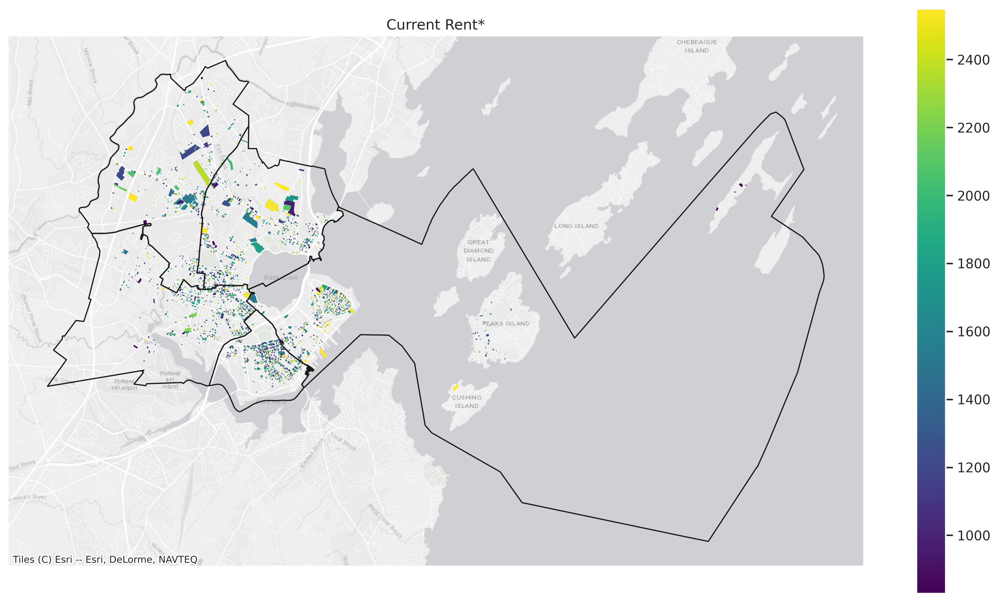

In [11]:
ax = gdf[~gdf["outlier"]].plot(
    "CurrentRent1",
    figsize=(16,9), 
    legend=True, 
    cmap="viridis", edgecolor="none",
    vmin=quantiles["CurrentRent1"].iloc[0], 
    vmax=quantiles["CurrentRent1"].iloc[1]
    )
ax.set_title("Current Rent*")
wards.plot(ax=ax, facecolor='none', edgecolor='k')
ax.axis("off")
cx.add_basemap(ax, source=cx.providers.Esri.WorldGrayCanvas)

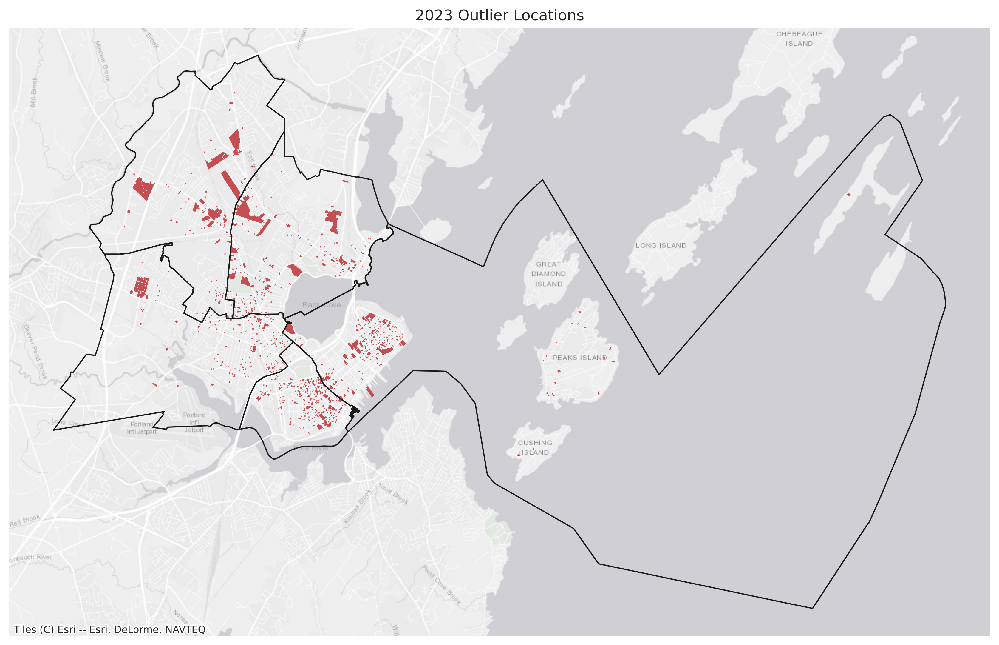

In [12]:
ax = gdf[gdf["outlier"]].plot(color="r", edgecolor='none', figsize=(16,9))
ax.set_title("2023 Outlier Locations")
wards.plot(ax=ax, facecolor='none', edgecolor='k')
ax.axis("off")
cx.add_basemap(ax, source=cx.providers.Esri.WorldGrayCanvas)

## Ward Statistics

In [13]:
gdf_median = wards.merge(gdf[~gdf["outlier"]].groupby("WARD").median(), left_on="NAME", right_index=True)
gdf_sum = wards.merge(gdf.groupby("WARD").sum(), left_on="NAME", right_index=True)

## Maps (Choropleths)

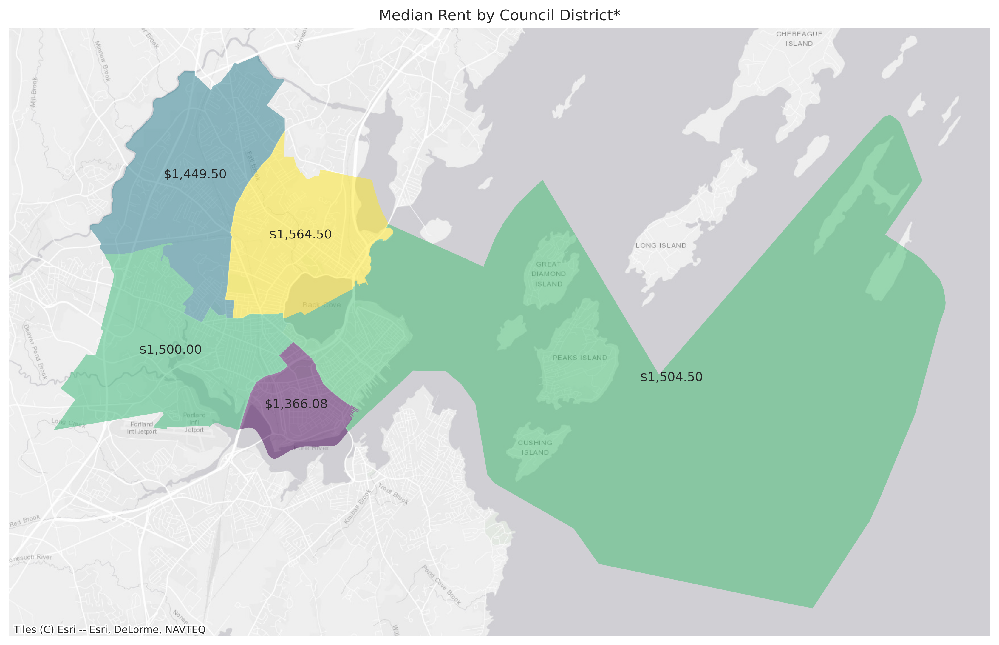

In [14]:
ax = gdf_median.plot("CurrentRent1", cmap="viridis", edgecolor="none", figsize=(16,9), alpha=0.5)
gdf_median.apply(lambda x: ax.annotate(text=f"${x['CurrentRent1']:,.2f}", xy=x.geometry.centroid.coords[0], ha='center'), axis=1)
ax.set_title("Median Rent by Council District*")
ax.axis("off")
cx.add_basemap(ax, source=cx.providers.Esri.WorldGrayCanvas)

Text(0, 0.5, 'Current Rent')

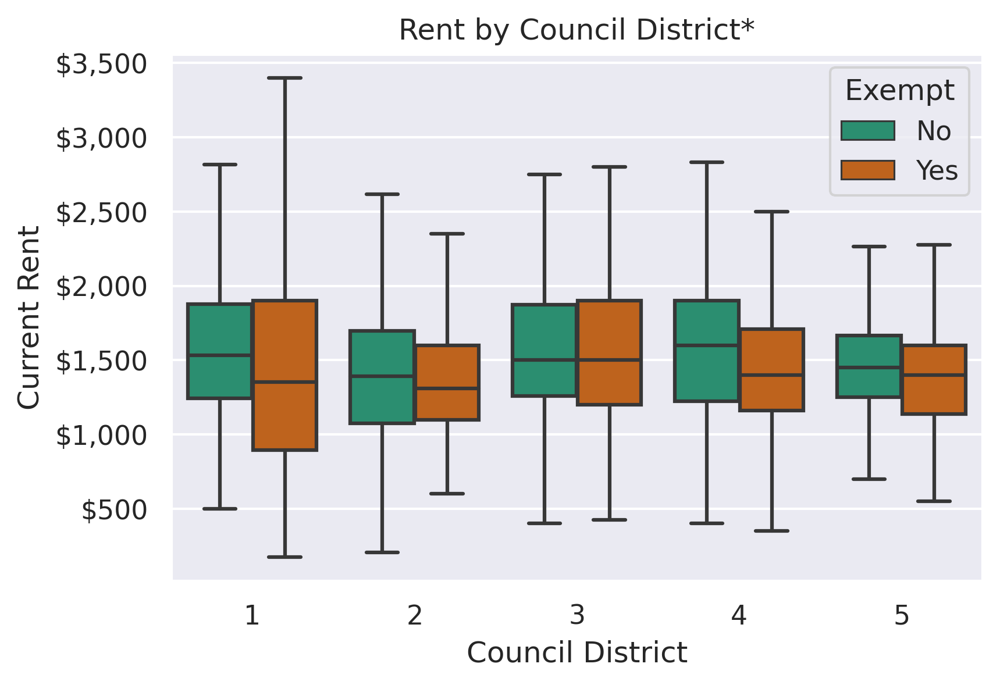

In [15]:
ax = sns.boxplot(
    data=gdf[~gdf["outlier"]].sort_values("WARD"),
    x="WARD_str",
    y="CurrentRent1",
    hue="exempt",
    showfliers=False,
    )
ax.set_title("Rent by Council District*")
handles, labels = ax.get_legend_handles_labels()
ax.legend(title="Exempt", handles=handles, labels=["No", "Yes"])
ax.get_xaxis().set_label_text("Council District")
ax.get_yaxis().set_major_formatter(mpl.ticker.FuncFormatter(lambda x, p: '${:,}'.format(int(x))))
ax.set_ylabel("Current Rent")

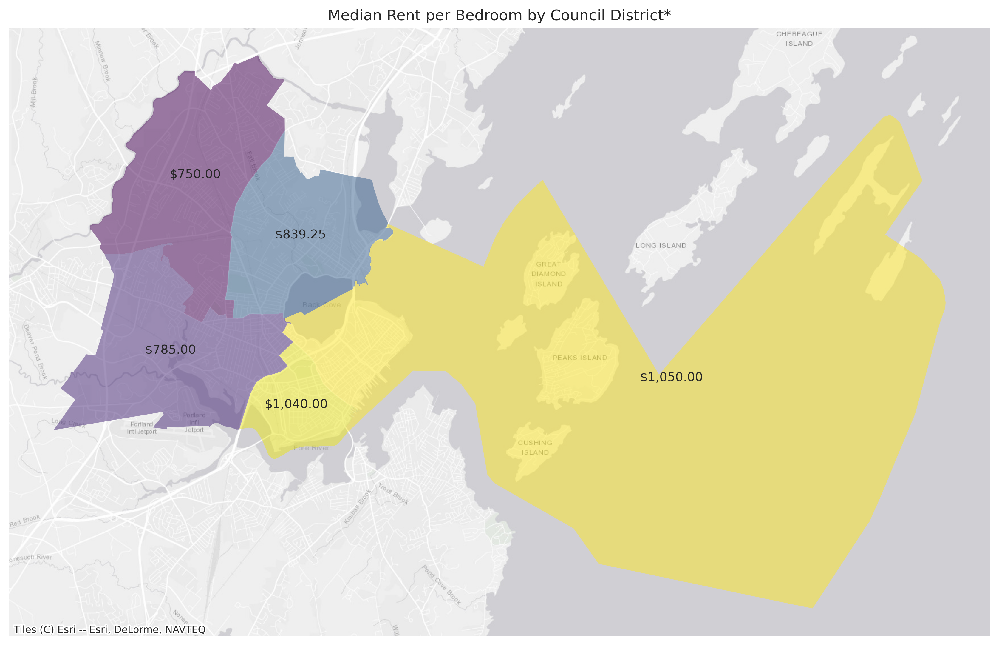

In [16]:
ax = gdf_median.plot("Rent_per_BedRms", cmap="viridis", edgecolor="none", figsize=(16,9), alpha=0.5)
gdf_median.apply(lambda x: ax.annotate(text=f"${x['Rent_per_BedRms']:,.2f}", xy=x.geometry.centroid.coords[0], ha='center'), axis=1)
ax.set_title("Median Rent per Bedroom by Council District*")
cx.add_basemap(ax, source=cx.providers.Esri.WorldGrayCanvas)
ax.axis('off');

Text(0.5, 0, 'Council District')

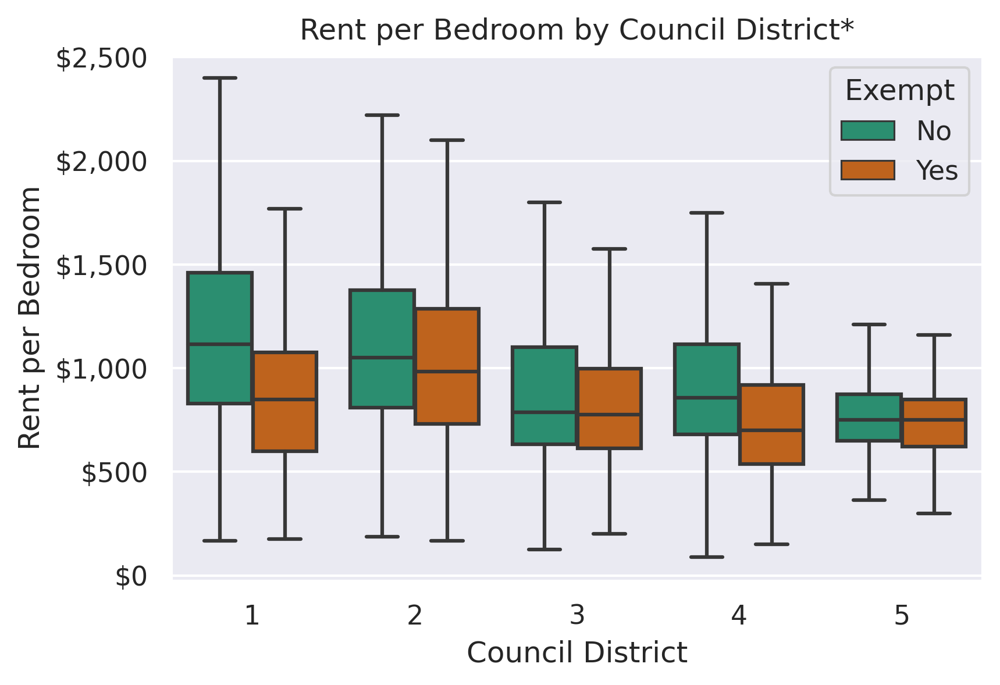

In [17]:
ax = sns.boxplot(
    data=gdf[~gdf["outlier"]].sort_values("WARD"),
    x="WARD_str",
    y="Rent_per_BedRms",
    hue="exempt",
    showfliers=False,
    )
ax.set_title("Rent per Bedroom by Council District*")
handles, labels = ax.get_legend_handles_labels()
ax.legend(title="Exempt", handles=handles, labels=["No", "Yes"])
ax.get_yaxis().set_major_formatter(mpl.ticker.FuncFormatter(lambda x, p: '${:,}'.format(int(x))))
ax.set_ylabel("Rent per Bedroom")
ax.set_xlabel("Council District")

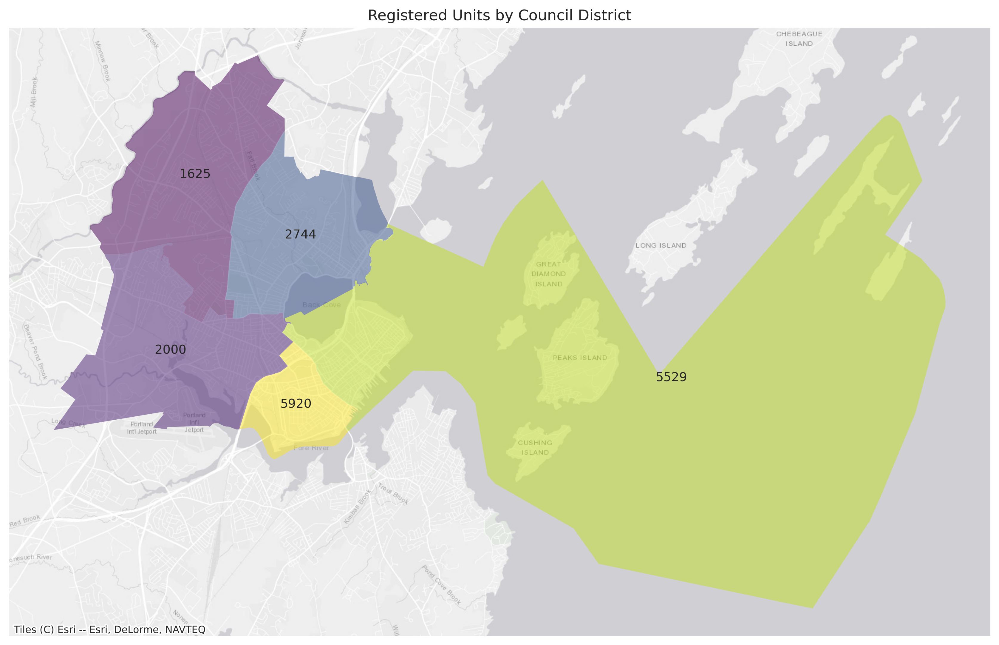

In [18]:
ax = gdf_sum.plot("Count", cmap="viridis", edgecolor="none", figsize=(16,9), alpha=0.5)
gdf_sum.apply(lambda x: ax.annotate(text=x['Count'], xy=x.geometry.centroid.coords[0], ha='center'), axis=1)
ax.set_title("Registered Units by Council District")
cx.add_basemap(ax, source=cx.providers.Esri.WorldGrayCanvas)
ax.axis('off');

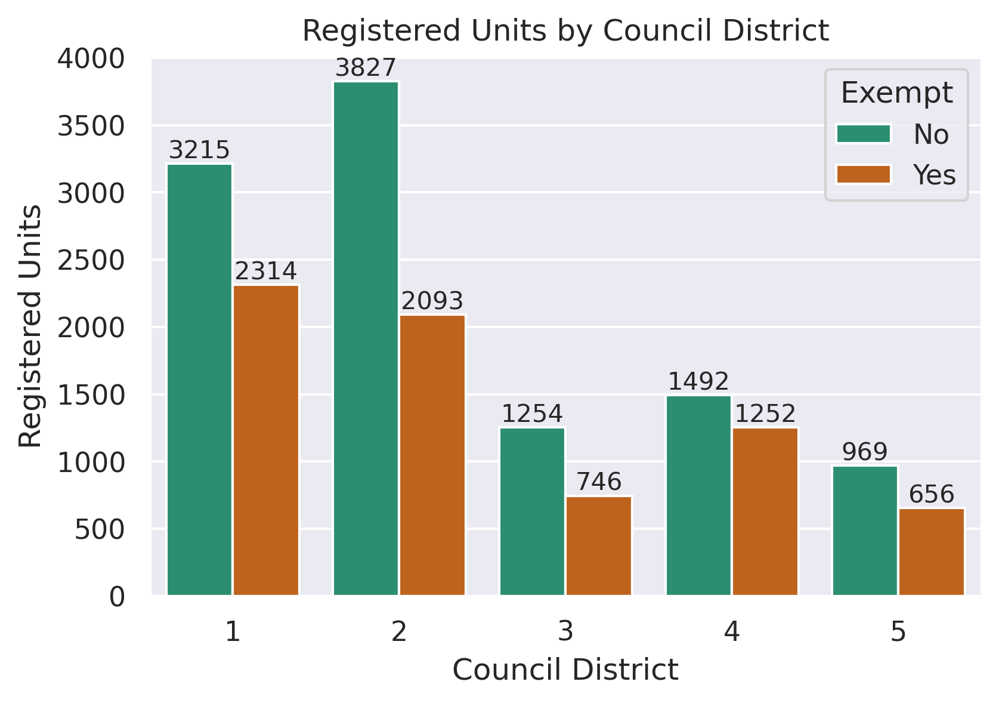

In [19]:
ax = sns.barplot(
    data=gdf.sort_values("WARD"),
    x="WARD_str",
    y="Count",
    hue="exempt",
    estimator=np.sum
    )
ax.set_title("Registered Units by Council District")
handles, labels = ax.get_legend_handles_labels()
ax.legend(title="Exempt", handles=handles, labels=["No", "Yes"])
ax.set_xlabel("Council District")
ax.set_ylabel("Registered Units")
for bars in ax.containers:
    ax.bar_label(
        bars,
        fmt='%d',
        label_type='edge'
        )

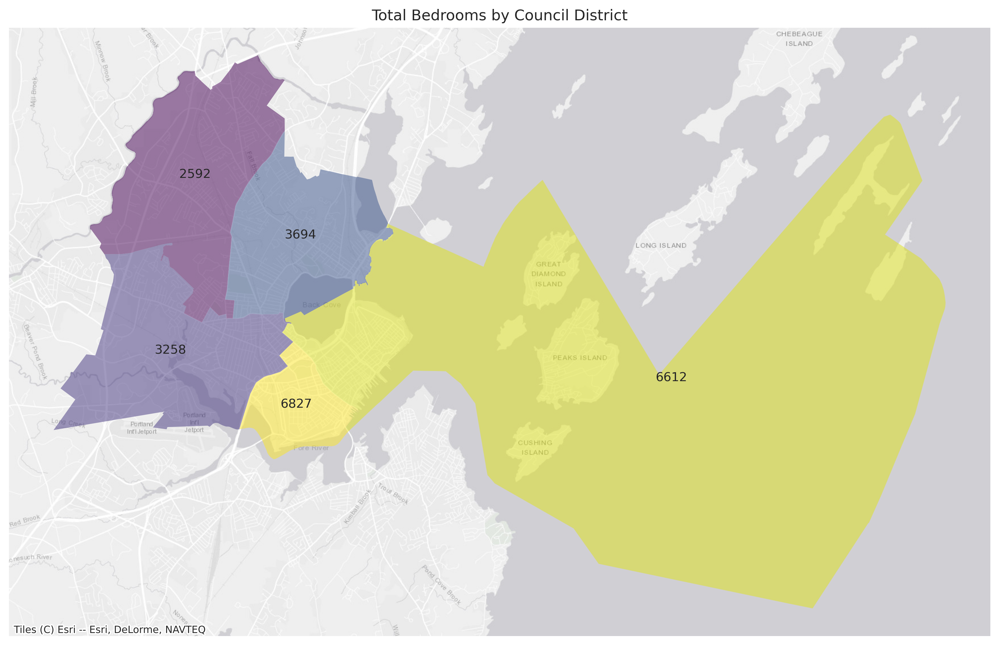

In [20]:
ax = gdf_sum.plot("nbrBedRms1",cmap="viridis", edgecolor="none", figsize=(16,9), alpha=0.5)
gdf_sum.apply(lambda x: ax.annotate(text=x['nbrBedRms1'], xy=x.geometry.centroid.coords[0], ha='center'), axis=1)
ax.set_title("Total Bedrooms by Council District")
cx.add_basemap(ax, source=cx.providers.Esri.WorldGrayCanvas)
ax.axis('off');

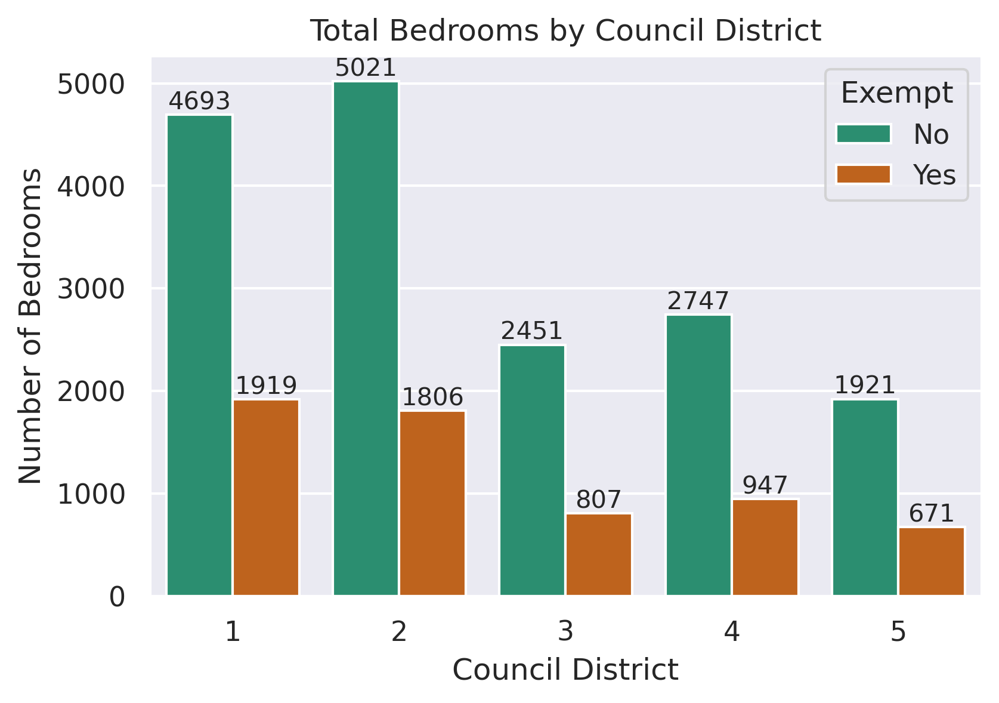

In [21]:
ax = sns.barplot(
    data=gdf.sort_values("WARD"),
    x="WARD_str",
    y="nbrBedRms1",
    hue="exempt",
    estimator=np.sum,
    errorbar=None
    )
ax.set_title("Total Bedrooms by Council District")
handles, labels = ax.get_legend_handles_labels()
ax.legend(title="Exempt", handles=handles, labels=["No", "Yes"])
ax.set_xlabel("Council District")
ax.set_ylabel("Number of Bedrooms")
for bars in ax.containers:
    ax.bar_label(
        bars,
        fmt='%d',
        label_type='edge'
        )

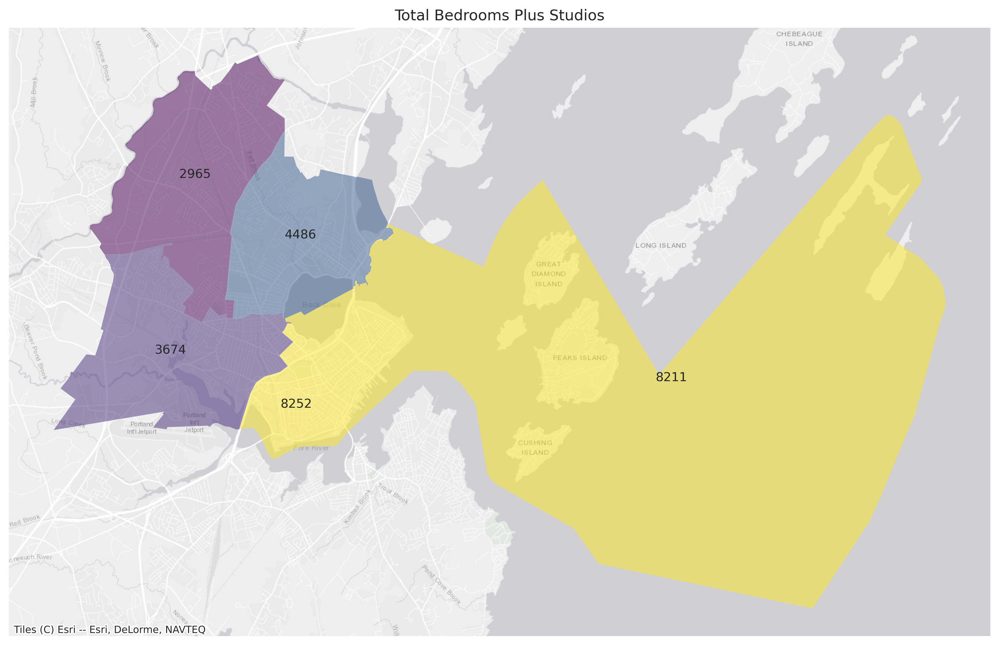

In [22]:
ax = gdf_sum.plot("nbrBedRms_studio", cmap="viridis", edgecolor="none", figsize=(16,9), alpha=0.5)
gdf_sum.apply(lambda x: ax.annotate(text=x['nbrBedRms_studio'], xy=x.geometry.centroid.coords[0], ha='center'), axis=1)
ax.set_title("Total Bedrooms Plus Studios")
cx.add_basemap(ax, source=cx.providers.Esri.WorldGrayCanvas)
ax.axis('off');

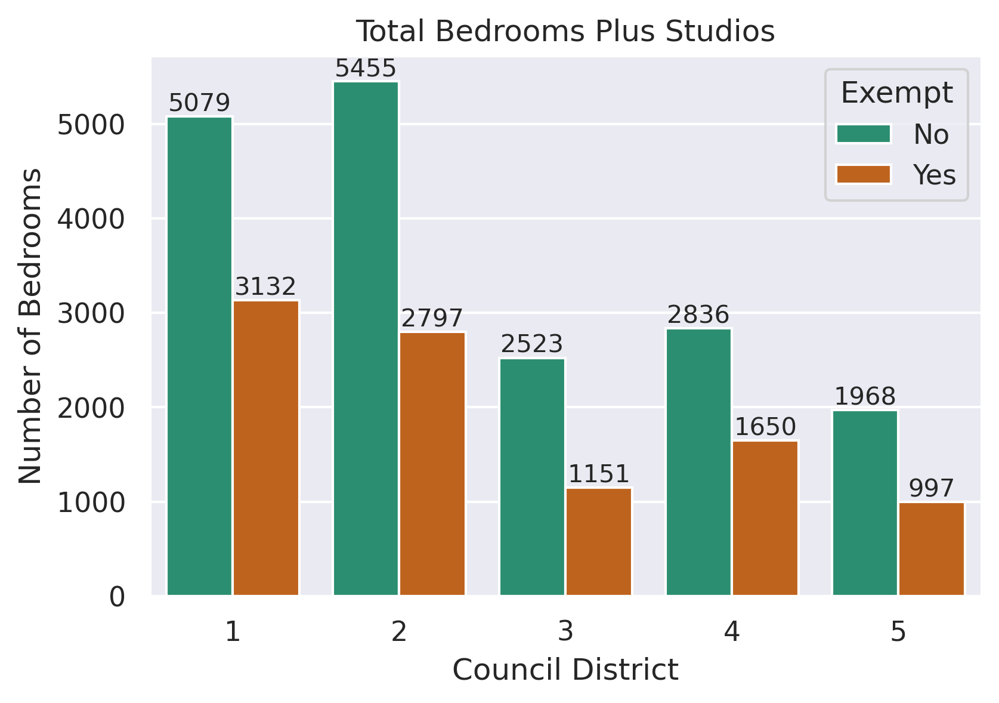

In [23]:
ax = sns.barplot(
    data=gdf.sort_values("WARD"),
    x="WARD_str",
    y="nbrBedRms_studio",
    hue="exempt",
    estimator=np.sum,
    errorbar=None
    )
ax.set_title("Total Bedrooms Plus Studios")
handles, labels = ax.get_legend_handles_labels()
ax.legend(title="Exempt", handles=handles, labels=["No", "Yes"])
ax.set_xlabel("Council District")
ax.set_ylabel("Number of Bedrooms")
for bars in ax.containers:
    ax.bar_label(
        bars,
        fmt='%d',
        label_type='edge'
        )

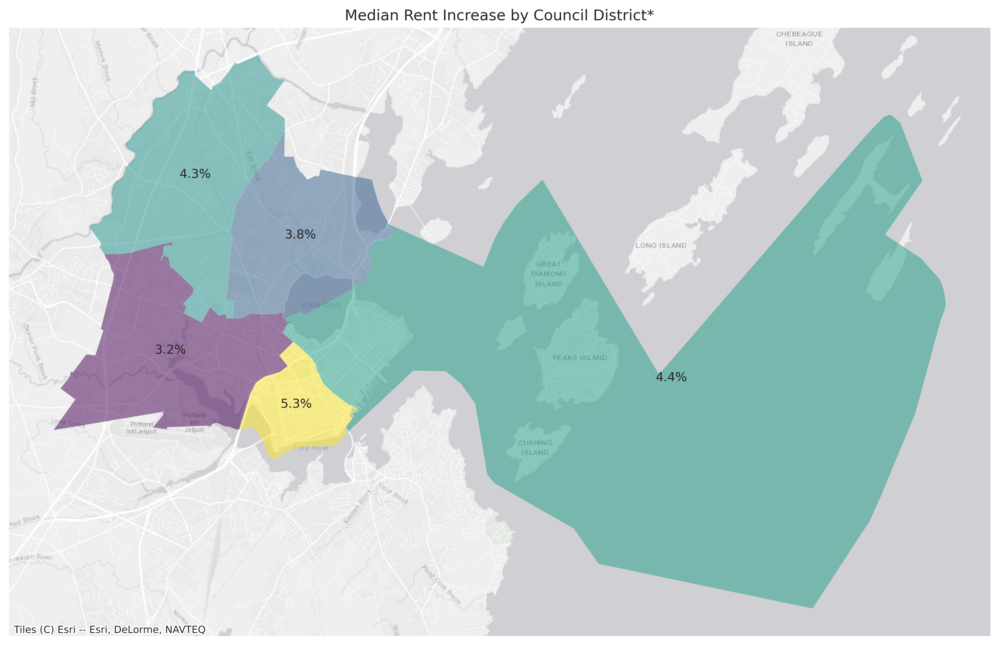

In [24]:
ax = gdf_median.plot("Rent_Inc_percent", cmap="viridis", edgecolor="none", figsize=(16,9), alpha=0.5)
gdf_median.apply(lambda x: ax.annotate(text=f"{x['Rent_Inc_percent']:.1f}%", xy=x.geometry.centroid.coords[0], ha='center'), axis=1)
ax.set_title("Median Rent Increase by Council District*")
cx.add_basemap(ax, source=cx.providers.Esri.WorldGrayCanvas)
ax.axis('off');

Text(0.5, 0, 'Council District')

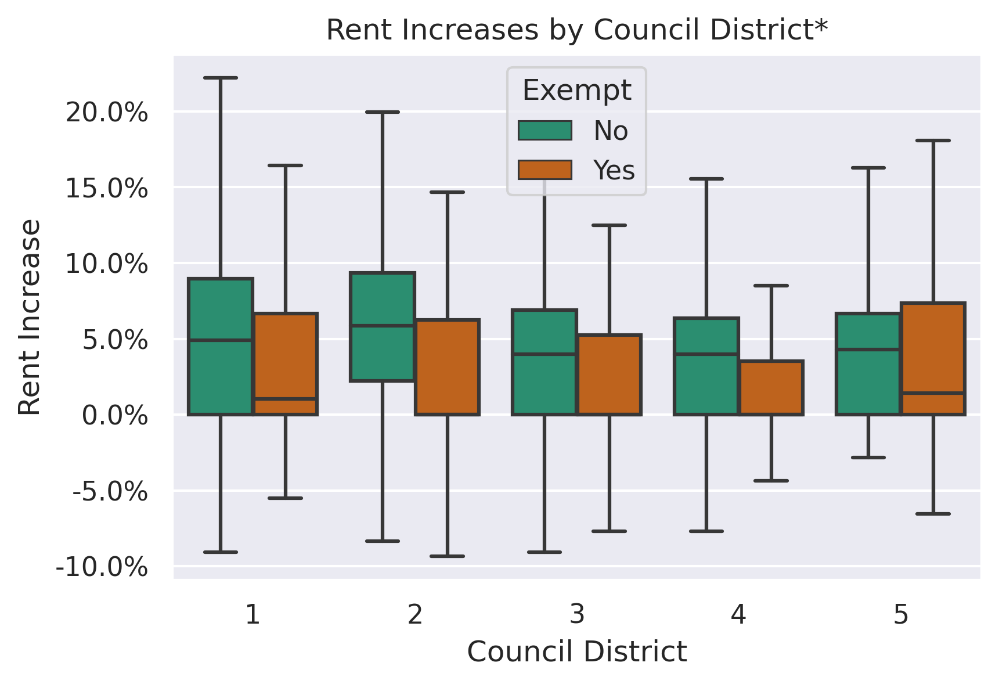

In [25]:
ax = sns.boxplot(
    data=gdf[~gdf["outlier"]].sort_values("WARD"),
    x="WARD_str",
    y="Rent_Inc_percent",
    hue="exempt",
    showfliers=False
    )
ax.set_title("Rent Increases by Council District*")
handles, labels = ax.get_legend_handles_labels()
ax.legend(title="Exempt", handles=handles, labels=["No", "Yes"])
ax.get_yaxis().set_major_formatter(mpl.ticker.FuncFormatter(lambda x, p: '{:.1f}%'.format(int(x))))
ax.set_ylabel("Rent Increase")
ax.set_xlabel("Council District")


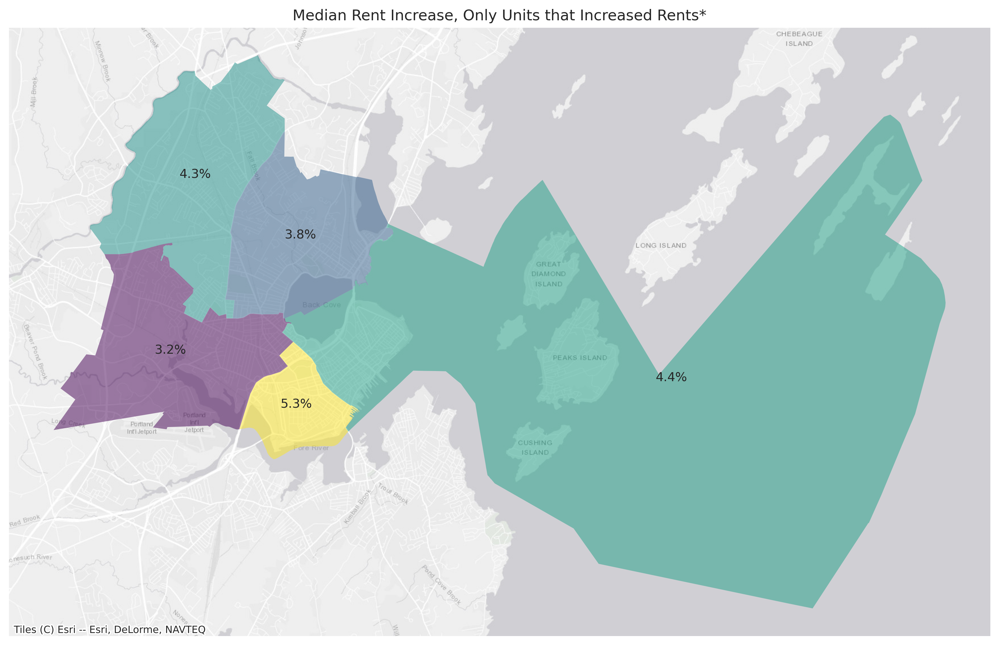

In [26]:
ax = gdf_median.plot("Rent_Inc_percent", cmap="viridis", edgecolor="none", figsize=(16,9), alpha=0.5)
gdf_median.apply(lambda x: ax.annotate(text=f"{x['Rent_Inc_percent']:.1f}%", xy=x.geometry.centroid.coords[0], ha='center'), axis=1)
ax.set_title("Median Rent Increase, Only Units that Increased Rents*")
cx.add_basemap(ax, source=cx.providers.Esri.WorldGrayCanvas)
ax.axis('off');

Text(0.5, 0, 'Council District')

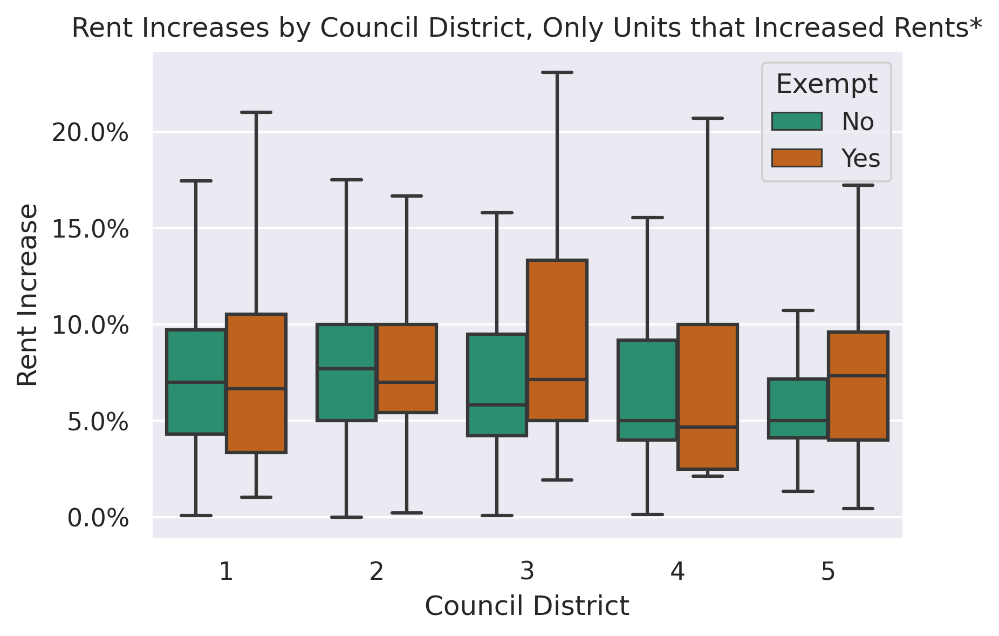

In [27]:
ax = sns.boxplot(
    data=gdf[~gdf["outlier"] & (gdf["Rent_Inc"] > 0)].sort_values("WARD"),
    x="WARD_str",
    y="Rent_Inc_percent",
    hue="exempt",
    showfliers=False
    )
ax.set_title("Rent Increases by Council District, Only Units that Increased Rents*")
handles, labels = ax.get_legend_handles_labels()
ax.legend(title="Exempt", handles=handles, labels=["No", "Yes"])
ax.get_yaxis().set_major_formatter(mpl.ticker.FuncFormatter(lambda x, p: '{:.1f}%'.format(int(x))))
ax.set_ylabel("Rent Increase")
ax.set_xlabel("Council District")